# LAB TASKS 2 g/n on 18july24

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import cv2

#### Task 1
1. Read the input image (preferably 256 x 256 gray scale cameraman image)
2. Blur the image by passing it through low pass filter. (Chose the mask in such a way
that blurring effect is visible)
3. Subtract the blurred version of the image from the input image and comment on the
observed result.

((256, 256), <matplotlib.image.AxesImage at 0x705f1bd317c0>)

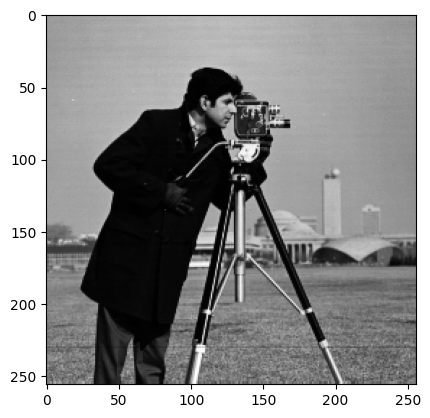

In [2]:
# 1
img = cv2.imread('cameraman.tif', cv2.IMREAD_GRAYSCALE)
img.shape, plt.imshow(img, cmap='gray')

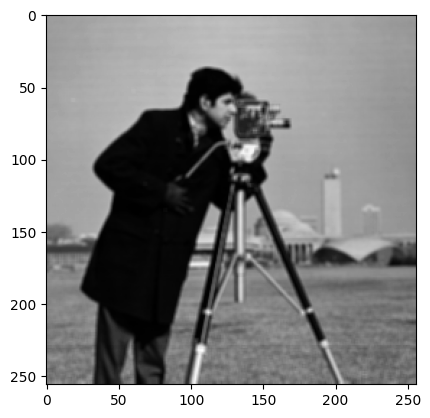

In [3]:
# 2
mask_dimension = 3
h = 1/(mask_dimension**2) * np.ones((mask_dimension, mask_dimension))
blurred_img = cv2.filter2D(img, -1, h)
plt.imshow(blurred_img, cmap='gray')

(<Axes: title={'center': 'img - blurred_img'}>,
 Text(0.5, 1.0, 'img - blurred_img'),
 <matplotlib.image.AxesImage at 0x705f1af39a90>)

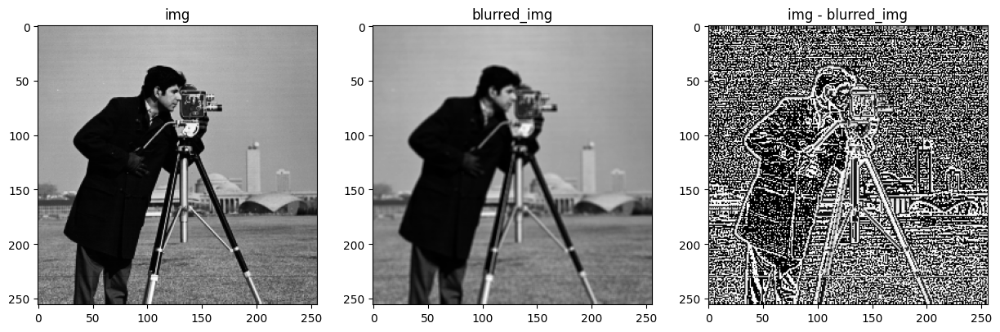

In [4]:
# 3
plt.figure(figsize=(15, 5))
plt.subplot(131),plt.title('img'),plt.imshow(img, cmap='gray')
plt.subplot(132),plt.title('blurred_img'),plt.imshow(blurred_img, cmap='gray')
plt.subplot(133),plt.title('img - blurred_img'),plt.imshow(img - blurred_img, cmap='gray')

**Observation:** We're able to pickup the changes in grays levels.

#### Task 2
1. Read the input image (gray scale image)
2. Add random noise to the input image.
3. Pass the noisy image through high pass filter and comment on the observed result.

((256, 256), <matplotlib.image.AxesImage at 0x705f1afceb40>)

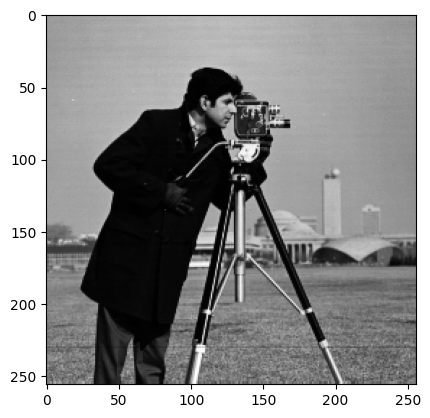

In [5]:
# 1
img = cv2.imread('cameraman.tif', cv2.IMREAD_GRAYSCALE)
img.shape, plt.imshow(img, cmap='gray')

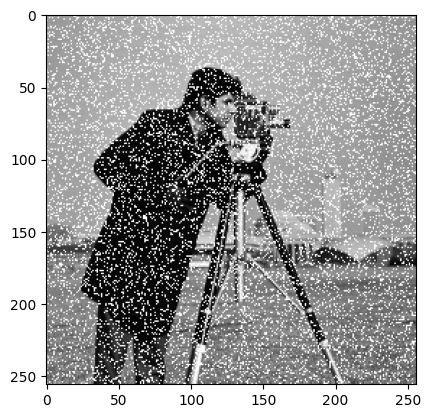

In [6]:
# 2 (Adding Gaussian Noise)
noisy_img = cv2.add(img, np.random.normal(0, 1, img.shape).astype(np.uint8))
plt.imshow(noisy_img, cmap='gray')

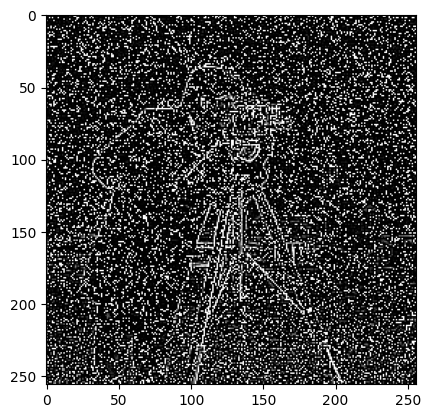

In [7]:
plt.imshow(cv2.filter2D(noisy_img, -1, np.array([[-1,-1,-1],[-1,8,-1],[-1,-1,-1]])), cmap='gray')

**Observation:** Changes are detected due to the HPF. Since the noise added is also a drastic change, it's also detected by the HPF.

#### Task 3
Write python code to perform Vector Quantization of the input matrix as discussed in the class.

In [8]:
from scipy.spatial.distance import cdist

def vector_quantization(img, R, L):
    # Setup
    code_vector_count = 2 ** (R*L)
    img_blocks = img.reshape(-1, L)
    interval_width = np.ceil((np.max(img) - np.min(img))/(R*L))
    
    # Generate code vectors
    intervals = np.arange(0, 16, interval_width)
    code_vectors = np.array([(((r+r+interval_width)/2, (c+c+interval_width)/2)) for r in intervals for c in intervals])

    # Find nearest code vector for each image block
    distances = cdist(img_blocks, code_vectors)
    nearest_indices = np.argmin(distances, axis=1)
    
    # Quantization
    quantized_blocks = code_vectors[nearest_indices]
    quantized_image = quantized_blocks.reshape(img.shape)

    return quantized_image

(<Axes: title={'center': 'quantized_img'}>,
 Text(0.5, 1.0, 'quantized_img'),
 <matplotlib.image.AxesImage at 0x705f19bb3830>)

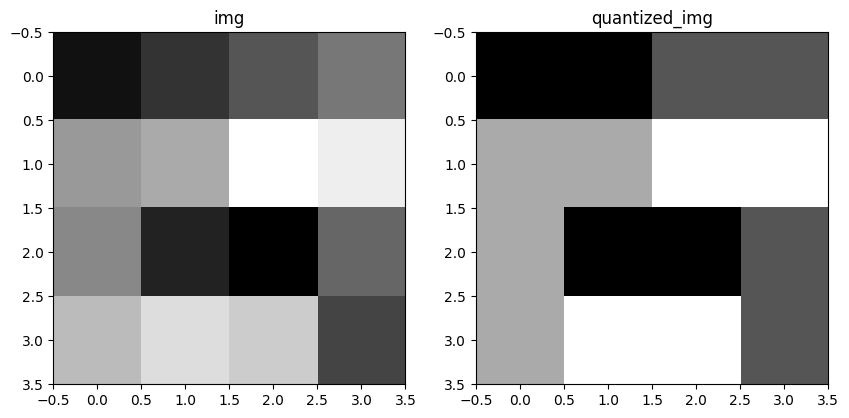

In [9]:
# Example img from the slides
img = np.array([[2, 4, 6, 8],
              [10, 11, 16, 15],
              [9, 3, 1, 7],
              [12, 14, 13, 5]]).astype(float)

quantized_img = vector_quantization(img, 2, 2)

plt.figure(figsize=(10, 5))
plt.subplot(121), plt.title("img"), plt.imshow(img, cmap='gray')
plt.subplot(122), plt.title("quantized_img"), plt.imshow(quantized_img, cmap='gray')

#### Task 4
Write a python code to perform 
- nearest neighbor
- Bilinear
- Bicubic interpolation


of the input image and comment on the observed result.

In [10]:
img = cv2.imread('cameraman.tif', cv2.IMREAD_GRAYSCALE)

nearest = cv2.resize(img, np.array(img.shape)*8, cv2.INTER_NEAREST)
bilinear = cv2.resize(img, np.array(img.shape)*8, cv2.INTER_LINEAR)
bicubic = cv2.resize(img, np.array(img.shape)*8, cv2.INTER_CUBIC)

plt.figure(figsize=(256, 256)) # That is pretty big. It will take a while.
plt.subplot(421), plt.imshow(img, cmap='gray'), plt.title('Original')
plt.subplot(422), plt.imshow(nearest, cmap='gray'), plt.title('Nearest Neighbor')
plt.subplot(423), plt.imshow(img, cmap='gray'), plt.title('Original')
plt.subplot(424), plt.imshow(bilinear, cmap='gray'), plt.title('Bilinear')
plt.subplot(425), plt.imshow(img, cmap='gray'), plt.title('Original')
plt.subplot(426), plt.imshow(bicubic, cmap='gray'), plt.title('Bicubic')

(<Axes: title={'center': 'Bicubic'}>,
 Text(0.5, 1.0, 'Bicubic'))

**Obervations:** No visible difference.

#### Task 5
Write a python code to perform resizing of the input image. If the input image size is 256 x 256, first resize it to 128 x 128, then resize the input image to 512 x 512 and comment on the observed result.

In [11]:
img = cv2.imread('cameraman.tif', cv2.IMREAD_GRAYSCALE)

In [12]:
half = cv2.resize(img, (128, 128))
bigger = cv2.resize(img, (512, 512))
plt.figure(figsize=(256, 256)) # That is pretty big. It will take a while.
plt.subplot(131),plt.title('img'),plt.imshow(img, cmap='gray')
plt.subplot(132),plt.title('half'),plt.imshow(half, cmap='gray')
plt.subplot(133),plt.title('bigger'),plt.imshow(bigger, cmap='gray')

(<Axes: title={'center': 'bigger'}>,
 Text(0.5, 1.0, 'bigger'),
 <matplotlib.image.AxesImage at 0x705ee7fa1f70>)

**Observations:** At original size, visualizing the images we can see that, as the no. of pixels decrease, we are able to increasingly see individual pixels and rough edges.

#### Task 6
Generate an 8 x 8 image which is given by `f[m,n]=|m-n|` for m,n=0,1,2,3,4,5,6,7. Pass this image through 3x3 average filter, 3x3 weighted average filter. Use subplot to plot the generated image, average filtered image and weighted average filtered image and comment on the observed result.

##### Solution:
1. Generate an 8x8 image where each pixel value is given by `f[m,n] = |m - n|`.
2. Apply a 3x3 average filter and the weighted average filter to this image.
3. Use subplots to plot the original, average filtered, and weighted average filtered images.
4. Comment on the observed results.

In [13]:
# Step 1: Generate the 8x8 image with f[m, n] = |m - n|
img = np.abs(np.arange(8).reshape(-1, 1) - np.arange(8).reshape(1, -1)).astype(float)

In [14]:
# Step 2: Apply the 3x3 average filter and the weighted average filter
average_filter = np.ones((3, 3)) / 9
weighted_filter = np.array([[4, 0, 4], [0, 0, 0], [4, 0, 4]]) / 16 # More weightage to the corners. Very unlikely filter.
average_filtered_image = cv2.filter2D(img, -1, average_filter)
weighted_average_filtered_image = cv2.filter2D(img, -1, weighted_filter)

(<Axes: title={'center': 'weighted_average_filtered_image'}>,
 Text(0.5, 1.0, 'weighted_average_filtered_image'),
 <matplotlib.image.AxesImage at 0x705ee6cbdf10>)

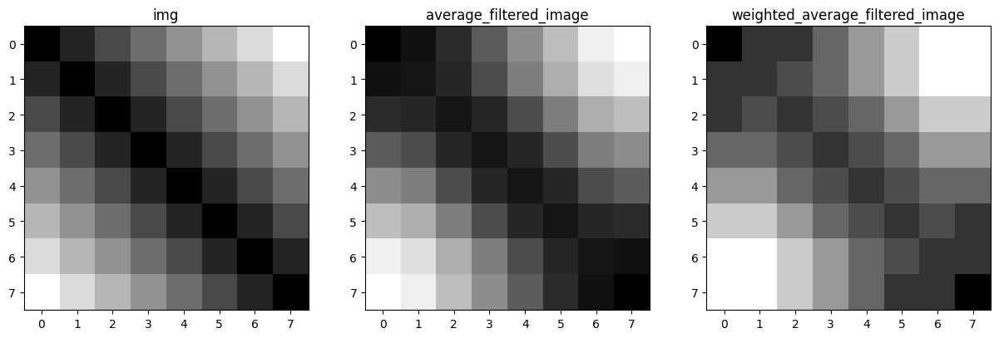

In [15]:
# Step 3: Use subplots to plot the original, average filtered, and weighted average filtered images.
plt.figure(figsize=(15, 5))
plt.subplot(131), plt.title('img'), plt.imshow(img, cmap='gray')
plt.subplot(132), plt.title('average_filtered_image'), plt.imshow(average_filtered_image, cmap='gray')
plt.subplot(133), plt.title('weighted_average_filtered_image'), plt.imshow(weighted_average_filtered_image, cmap='gray')

**Observations:** The average filter produces a more unbiased result while the weighted average filter gives a result with defined importance.
Here, with the weightage given to the very unlikely corners, the image varies vastly from the original.

#### Task 7
Generate the 16  x 16 image which is given in [here](https://docs.google.com/document/d/1FHUmiaTkVWdE714qVdJpvjYEfSpXEnsP/edit).

In [16]:
# Step 1: Generate the 15x15 image with values as the minimum distance to the nearest edge
img = np.zeros((16, 16))
for i in range(16):
    for j in range(16):
        img[i, j] = min(i, j, 15-i, 15-j)

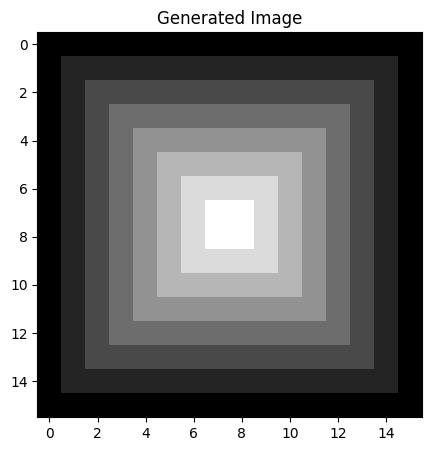

In [17]:
# Step 2: Plot the generated image
plt.figure(figsize=(15, 5))
plt.title("Generated Image")
plt.imshow(img, cmap='gray')